In [ ]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go


In [3]:
df=pd.read_csv("../data/processed_data/train.csv")

In [4]:
df.head(10)

,airport_group,timestamp,target_actual,target_sched,flights_cnt,avg_duration,max_duration,passenger_share,cargo_share,charter_share,...,holiday,month,hournum,weekend,date,daily_flights_cnt,flights_cnt_prev,flights_cnt_next,mean(air_temperature P1D),sum(precipitation_amount P1D)
0,B,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,34,0,0,NaN,NaN
1,F,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,23,0,0,NaN,NaN
2,A,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,25,0,0,1.0,0.3
3,C,2018-01-01 07:00:00,0,1,2,27.50,35.0,1.0,0.0,0.0,...,True,1,7,0,2018-01-01,28,0,4,NaN,NaN
4,G,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,29,0,0,NaN,NaN
5,E,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,37,0,0,NaN,NaN
6,D,2018-01-01 07:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,7,0,2018-01-01,34,0,0,NaN,NaN
7,B,2018-01-01 08:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,8,0,2018-01-01,34,0,0,NaN,NaN
8,F,2018-01-01 08:00:00,0,0,0,0.00,0.0,0.0,0.0,0.0,...,True,1,8,0,2018-01-01,23,0,0,NaN,NaN
9,C,2018-01-01 08:00:00,1,1,4,38.75,80.0,1.0,0.0,0.0,...,True,1,8,0,2018-01-01,28,2,2,NaN,NaN


In [5]:
fig = px.histogram(df, x="month",y='target_actual', color='airport_group')
fig.show()

In [6]:
fig = px.histogram(df, x="dow",y='target_actual', color='airport_group')
fig.show()

In [7]:
fig = px.histogram(df, x="hournum",y='target_actual', color='airport_group')
fig.show()

In [8]:
fig = px.histogram(df, x="avg_duration",y='target_actual', color='airport_group')
fig.show()

In [9]:
cm = (
    df.groupby(["target_sched", "target_actual"])
      .size()
      .reset_index(name="count")
)

fig = px.density_heatmap(
    cm, x="target_sched", y="target_actual", z="count", 
    text_auto=True, color_continuous_scale="Blues"
)
fig.update_layout(
    xaxis_title="Scheduled Target",
    yaxis_title="Actual Target",
    title="Scheduled vs Actual Simultaneity"
)
fig.show()

In [10]:
cm = (
    df.groupby(["target_sched", "target_actual"])
      .size()
      .reset_index(name="count")
)

# Beregn prosentandel av total
cm["percent"] = cm["count"] / cm["count"].sum() * 100

import plotly.express as px

fig = px.density_heatmap(
    cm, x="target_sched", y="target_actual", z="percent", 
    text_auto=".1f", color_continuous_scale="Blues"
)
fig.update_layout(
    xaxis_title="Scheduled Target",
    yaxis_title="Actual Target",
    title="Scheduled vs Actual Simultaneity (%)"
)
fig.show()

In [11]:
def mismatch_type(row):
    if row["target_sched"] == 1 and row["target_actual"] == 0:
        return "False Positive"
    elif row["target_sched"] == 0 and row["target_actual"] == 1:
        return "False Negative"
    else:
        return "Correct"

df["mismatch"] = df.apply(mismatch_type, axis=1)

In [12]:
df_mismatch = df.groupby(["hournum", "mismatch"]).size().reset_index(name="count")
df_total = df.groupby("hournum").size().reset_index(name="total")

df_mismatch = df_mismatch.merge(df_total, on="hournum")
df_mismatch["percent"] = df_mismatch["count"] / df_mismatch["total"] * 100

fig = px.bar(df_mismatch, x="hournum", y="percent", color="mismatch", 
             title="Mismatch-type per time på døgnet",
             labels={"hournum": "Time på dagen", "percent": "Andel (%)"})
fig.show()

In [13]:
df_flight = df.groupby(["flights_cnt", "mismatch"]).size().reset_index(name="count")
df_total_flight = df.groupby("flights_cnt").size().reset_index(name="total")

df_flight = df_flight.merge(df_total_flight, on="flights_cnt")
df_flight["percent"] = df_flight["count"] / df_flight["total"] * 100

px.line(df_flight, x="flights_cnt", y="percent", color="mismatch",
        title="Mismatch-type etter antall flyvninger per time",
        labels={"flights_cnt": "Antall fly per time", "percent": "Andel (%)"})

False negative -> Sched = 0, Actual = 1
False positive -> Sched = 1, Actual = 0

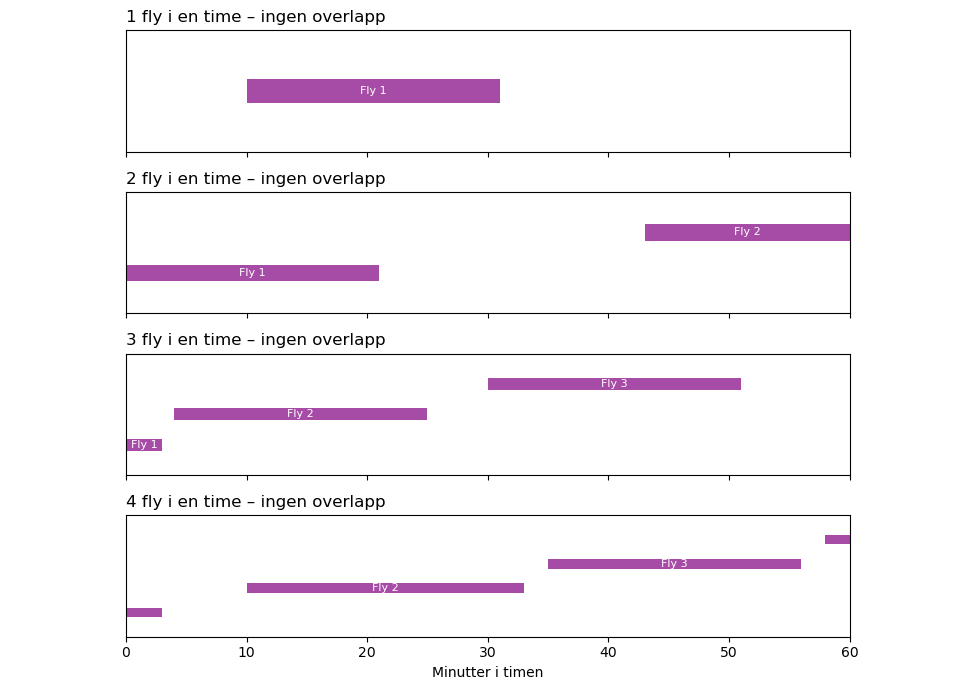

In [14]:
import matplotlib.pyplot as plt

def plot_no_overlap_examples():
    # Hvert intervall ~20 min langt
    examples = {
        1: [(10, 31)],  # Ett fly
        2: [(0, 21), (43, 60)],  # To fly, ingen overlapp
        3: [(0, 3), (4, 25), (30, 51)],  # Tre fly, tettpakket men ingen overlapp
        4: [(-20, 3), (10, 33), (35, 56), (58, 79)],  # Fire fly, akkurat uten overlapp
    }

    fig, axes = plt.subplots(len(examples), 1, figsize=(10, 7), sharex=True)

    for i, (n, intervals) in enumerate(examples.items(), start=1):
        ax = axes[i-1]
        for j, (s, e) in enumerate(intervals, start=1):
            ax.barh(y=j, width=e-s, left=s, height=0.4, color="purple", alpha=0.7)
            ax.text((s+e)/2, j, f"Fly {j}", va="center", ha="center", color="white", fontsize=8)
        
        ax.set_xlim(0, 60)
        ax.set_ylim(0, n+1)
        ax.set_yticks([])
        ax.set_title(f"{n} fly i en time – ingen overlapp", loc="left")

    plt.xlabel("Minutter i timen")
    plt.tight_layout()
    plt.show()

plot_no_overlap_examples()


In [15]:
px.histogram(df, x="hournum", color="target_actual",
             facet_col="target_sched", barmode="overlay")

In [16]:
px.histogram(df, x="dow", color="target_actual",
             facet_col="target_sched", barmode="overlay")

In [17]:
px.histogram(df, x="timestamp", y="flights_cnt",title="Distribution of Flights Over Time", color="airport_group")

In [18]:
# Beregn andel samtidighet per time
df_grouped = (
    df.groupby("flights_cnt")["target_actual"]
      .mean()  # gjennomsnitt = andel av 1-ere
      .reset_index(name="percent_concurrent")
)

# Gjør om til prosent
df_grouped["percent_concurrent"] *= 100

# Plot
fig = px.bar(
    df_grouped, x="flights_cnt", y="percent_concurrent",
    labels={"hournum": "Hour of Day", "percent_concurrent": "Samtidighet (%)"},
    title="Andel flyvninger med samtidighet per time"
)
fig.show()

In [19]:
df_dow = df.groupby("dow")["target_actual"].mean().reset_index()
df_dow["target_actual"] *= 100  # til prosent

px.bar(df_dow, x="dow", y="target_actual",
       title="Andel samtidighet per ukedag",
       labels={"dow": "Ukedag (0=mandag)", "target_actual": "Samtidighet (%)"})

In [20]:
df_month = df.groupby("month")["target_actual"].mean().reset_index()
df_month["target_actual"] *= 100

px.line(df_month, x="month", y="target_actual",
        title="Andel samtidighet per måned",
        labels={"month": "Måned", "target_actual": "Samtidighet (%)"})

In [21]:
df_group = df.groupby("airport_group")["target_actual"].mean().reset_index()
df_group["target_actual"] *= 100

px.bar(df_group, x="airport_group", y="target_actual",
       title="Andel samtidighet per flyplassgruppe",
       labels={"airport_group": "Flyplassgruppe", "target_actual": "Samtidighet (%)"})

In [22]:
px.histogram(df, x="avg_duration", color="target_actual",
             nbins=50, barmode="overlay",
             title="Fordeling av gjennomsnittlig flytid etter samtidighet",
             labels={"avg_duration": "Gj.snittlig flytid (min)", "target_actual": "Samtidighet"})


# Forskjeller i airline

In [23]:
#compute sums
flight_sum = (
    df.groupby("airline")[["flights_cnt"]]
      .sum()
)

fig = go.Figure()

# Add each column as its own bar trace
for col in flight_sum.columns:
    fig.add_trace(
        go.Bar(
            x=flight_sum.index,
            y=flight_sum[col],
            name=col,
            text=flight_sum[col],
            textposition='auto'
        )
    )

fig.update_layout(
    title="Number of flights per airline",
    xaxis_title="Airline",
    yaxis_title="Sum",
    barmode='group'  # or 'stack',
)

fig.show()


# Daily flights

In [24]:
df_flight = df.groupby(["daily_flights_cnt", "mismatch"]).size().reset_index(name="count")
df_total_flight = df.groupby("daily_flights_cnt").size().reset_index(name="total")

df_flight = df_flight.merge(df_total_flight, on="daily_flights_cnt")
df_flight["percent"] = df_flight["count"] / df_flight["total"] * 100

px.line(df_flight, x="daily_flights_cnt", y="percent", color="mismatch",
        title="Mismatch-type etter antall flyvninger per dag",
        labels={"daily_flights_cnt": "Antall fly per dag", "percent": "Andel (%)"})

# Forskjeller i flyplass

In [25]:
df_group = df.groupby(["airport_group", "mismatch"]).size().reset_index(name="count")
df_total_group = df.groupby("airport_group").size().reset_index(name="total")

df_group = df_group.merge(df_total_group, on="airport_group")
df_group["percent"] = df_group["count"] / df_group["total"] * 100

px.bar(df_group, x="airport_group", y="percent", color="mismatch",
        title="Mismatch-type etter flyplassgruppe",
        labels={"airport_group": "Flyplassgruppe", "percent": "Andel (%)"})